<a href="https://colab.research.google.com/github/V-Meenakshi/StockMovement/blob/main/StockMovementAnalyiss.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px # is a high-level interface for creating various types of interactive plots with minimal code.
import plotly.graph_objects as go # is a lower-level interface that offers more control and customization over the appearance and behavior of your plots

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import tweepy
import pandas as pd
import re

# Bearer Token (Replace with your token)
bearer_token = "AAAAAAAAAAAAAAAAAAAAAA2exAEAAAAAQ2JvsCciNakAzQOxThJsWSqMEc8%3DOvYtGYE8Rg6xsj3lJOVCwGNIwUmmWcNsVgdgniHFBQE6JRTYPM"

# Twitter API v2 Client
client = tweepy.Client(bearer_token=bearer_token, wait_on_rate_limit=True)

# Define search query and parameters
search_query = "\"Tesla\" OR \"TSLA\" OR \"MSFT, Inc.\"OR \"PG, Inc.\"OR \"META, Inc.\"OR \"AMZN, Inc.\"OR \"GOOG, Inc.\" -is:retweet -is:reply"
max_results_per_request = 60000  # Maximum tweets per request
total_tweets_to_fetch = 85000  # Total tweets to fetch across all requests

try:
    # Initialize variables for pagination
    all_tweets = []
    next_token = None

    while len(all_tweets) < total_tweets_to_fetch:
        # Fetch tweets with pagination
        response = client.search_recent_tweets(
            query=search_query,
            max_results=max_results_per_request,
            next_token=next_token,  # Use next_token to continue pagination
            tweet_fields=["created_at", "text"],
            expansions="author_id"
        )

        # Extract data from the response
        if response.data:
            for tweet in response.data:
                all_tweets.append({
                    "Date": tweet.created_at,
                    "Tweet": tweet.text,
                    "Stock Name": "TSLA",  # You can generalize this to be dynamic if needed
                    "Company Name": "Tesla, Inc."
                })

        # Check if there's a next_token for pagination
        next_token = response.meta.get("next_token", None)
        if not next_token:
            print("No more tweets to fetch.")
            break

        # Display progress
        print(f"Fetched {len(all_tweets)} tweets so far...")

    # Convert to DataFrame
    tweets_df = pd.DataFrame(all_tweets)

    # Preprocessing: Clean the tweets
    def clean_tweet(tweet):
        tweet = re.sub(r"@[A-Za-z0-9_]+", "", tweet)  # Remove mentions
        tweet = re.sub(r"#", "", tweet)  # Remove hashtags
        tweet = re.sub(r"http\S+|www\S+|https\S+", "", tweet, flags=re.MULTILINE)  # Remove URLs
        tweet = re.sub(r"[^\w\s]", "", tweet)  # Remove special characters
        tweet = re.sub(r"\s+", " ", tweet)  # Remove extra spaces
        return tweet.strip()

    tweets_df["Cleaned Tweet"] = tweets_df["Tweet"].apply(clean_tweet)

    # Display the DataFrame
    print(tweets_df.head())

    # Save to CSV
    tweets_df.to_csv("tesla_tweets.csv", index=False)
    print(f"Tweets saved to 'stock_tweets.csv'. Total tweets fetched: {len(all_tweets)}")

except Exception as e:
    print("Error:", str(e))


Fetched 100 tweets so far...
Fetched 200 tweets so far...
               Date Created  \
0 2024-11-24 13:41:52+00:00   
1 2024-11-24 13:41:52+00:00   
2 2024-11-24 13:41:52+00:00   
3 2024-11-24 13:41:52+00:00   
4 2024-11-24 13:41:51+00:00   

                                                Text  Number of Likes  \
0  Charles Schwab Eyes Spot Crypto Trading Once R...                0   
1  RT @TheBetterPath_: 8. Sunk Cost Fallacy\n\nWe...                0   
2  @ObjIFDividends I am going to do a refresh too...                0   
3  RT @Investor_DFS: Remember that people will hu...                0   
4                            https://t.co/r6ZKngnqVF                0   

  Source of Tweet                                      Cleaned Tweet  
0            None  Charles Schwab Eyes Spot Crypto Trading Once R...  
1            None  RT 8 Sunk Cost Fallacy We continue investing i...  
2            None  I am going to do a refresh too thinking of cha...  
3            None  RT Remember t

In [ ]:
from google.colab import files
files.download("stock_tweets.csv")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
df1 = pd.read_csv(r"/content/stock_tweets.csv")

In [ ]:
df1.head()

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc."


In [ ]:
df1.tail()

,Date,Tweet,Stock Name,Company Name
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,earning horizon quick snapshot large increase ...,XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavering pu...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.
80792,2021-09-30 10:22:52+00:00,xpeng deliver outstanding performance extreme ...,XPEV,XPeng Inc.


In [ ]:
df1.shape

(80793, 4)

In [ ]:
df1.columns

Index(['Date', 'Tweet', 'Stock Name', 'Company Name'], dtype='object')

In [ ]:
df1.duplicated().sum()

0

In [ ]:
df1.isnull().sum()

,0
Date,0
Tweet,1
Stock Name,0
Company Name,0


In [ ]:
# Remove rows with null values in the 'Tweet' column
df1 = df1.dropna(subset=['Tweet'])

# Verify that the null value is removed
print(df1.isnull().sum())

Date            0
Tweet           0
Stock Name      0
Company Name    0
dtype: int64


In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 80792 entries, 0 to 80792
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Date          80792 non-null  object
 1   Tweet         80792 non-null  object
 2   Stock Name    80792 non-null  object
 3   Company Name  80792 non-null  object
dtypes: object(4)
memory usage: 3.1+ MB


df1.describe()

In [ ]:
df1.nunique()

,0
Date,64423
Tweet,63322
Stock Name,25
Company Name,25


In [ ]:
df1['Stock Name'].unique()

array(['TSLA', 'MSFT', 'PG', 'META', 'AMZN', 'GOOG', 'AMD', 'AAPL',
       'NFLX', 'TSM', 'KO', 'F', 'COST', 'DIS', 'VZ', 'CRM', 'INTC', 'BA',
       'BX', 'NOC', 'PYPL', 'ENPH', 'NIO', 'ZS', 'XPEV'], dtype=object)

In [ ]:
df1['Stock Name'].value_counts()

,count
Stock Name,
TSLA,37422
TSM,11033
AAPL,5056
PG,4089
AMZN,4089
MSFT,4089
NIO,3021
META,2751
AMD,2227


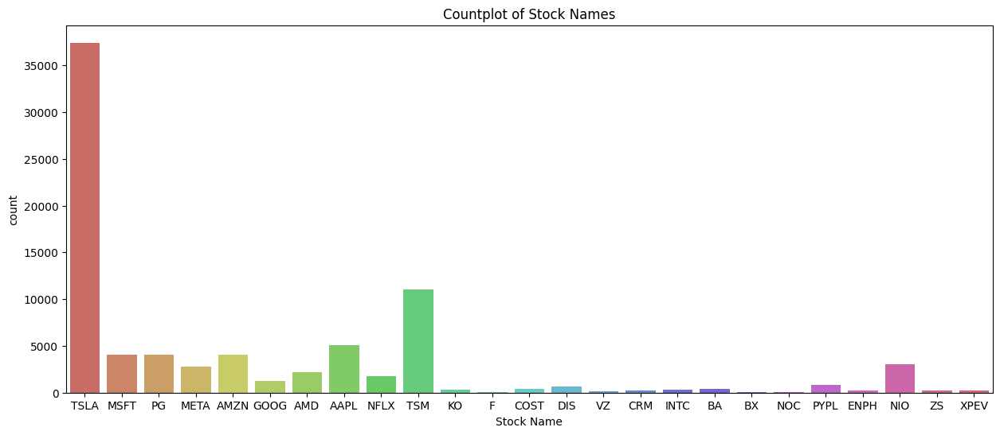

In [ ]:
plt.figure(figsize=(15,6))
sns.countplot(x = 'Stock Name', data = df1, palette = 'hls')
plt.title('Countplot of Stock Names')
plt.show()

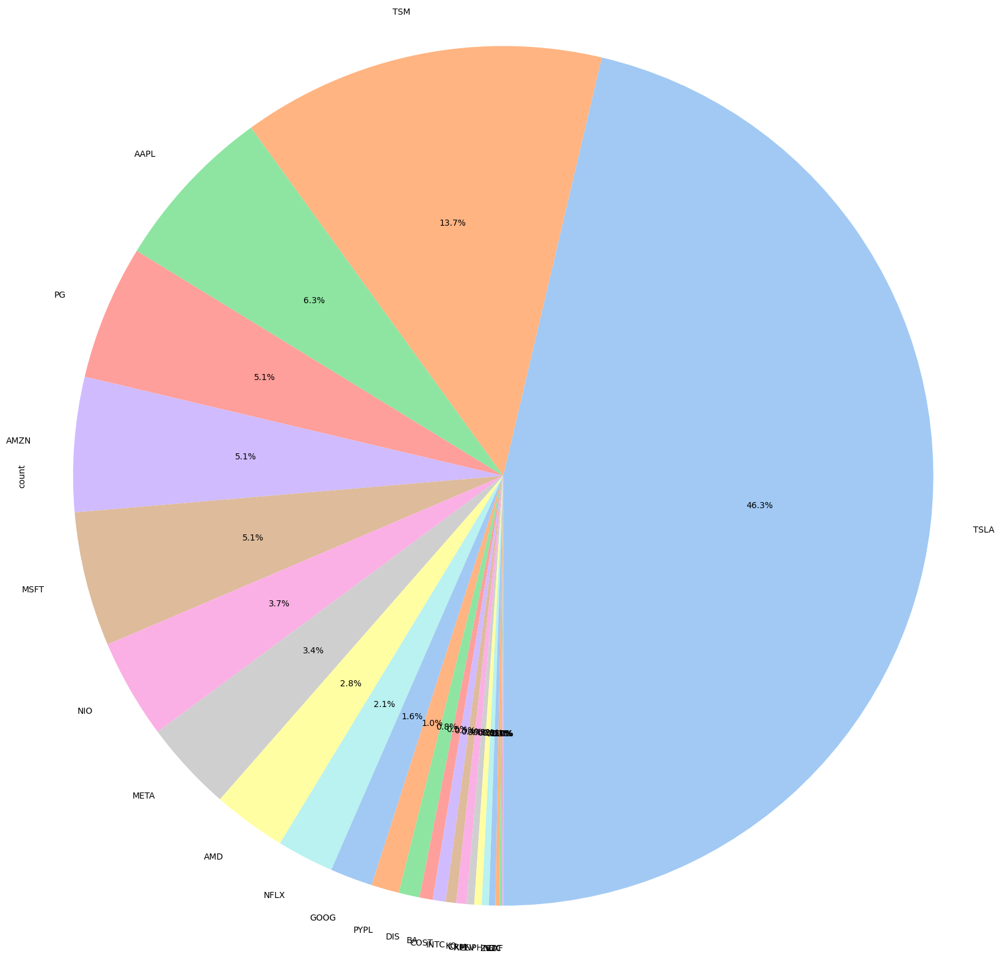

In [ ]:
plt.figure(figsize=(20, 20))
df1['Stock Name'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90, colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [ ]:
fig = go.Figure(data=[go.Bar(x=df1['Stock Name'].value_counts().index, y=df1['Stock Name'].value_counts())])
fig.update_layout(title='Countplot for Stock Name', xaxis_title= 'Stock Name', yaxis_title="Count")
fig.show()

In [ ]:
fig = px.pie(df1, names='Stock Name', title='Stock Name Distribution')
fig.update_layout(
    title='Stock Name Distribution',
    height=800,
    width=800
)
fig.show()

In [ ]:
df1['Company Name'].unique()

array(['Tesla, Inc.', 'Microsoft Corporation', 'Procter & Gamble Company',
       'Meta Platforms, Inc.', 'Amazon.com, Inc.', 'Alphabet Inc.',
       'Advanced Micro Devices, Inc.', 'Apple Inc.', 'Netflix, Inc.',
       'Taiwan Semiconductor Manufacturing Company Limited',
       'The Coca-Cola Company', 'Ford Motor Company',
       'Costco Wholesale Corporation', 'The Walt Disney Company',
       'Verizon Communications Inc.', 'Salesforce, Inc.',
       'Intel Corporation', 'The Boeing Company', 'Blackstone Inc.',
       'Northrop Grumman Corporation', 'PayPal Holdings, Inc.',
       'Enphase Energy, Inc.', 'NIO Inc.', 'Zscaler, Inc.', 'XPeng Inc.'],
      dtype=object)

In [ ]:
df1['Company Name'].value_counts()

,count
Company Name,
"Tesla, Inc.",37422
Taiwan Semiconductor Manufacturing Company Limited,11033
Apple Inc.,5056
Procter & Gamble Company,4089
"Amazon.com, Inc.",4089
Microsoft Corporation,4089
NIO Inc.,3021
"Meta Platforms, Inc.",2751
"Advanced Micro Devices, Inc.",2227


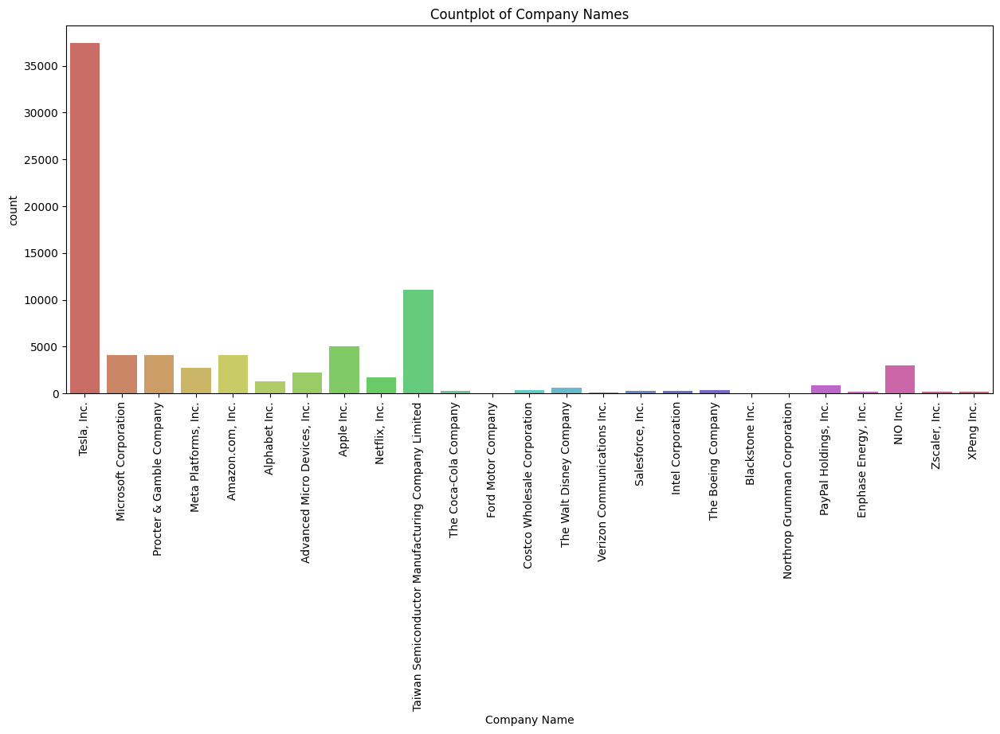

In [ ]:
plt.figure(figsize=(15,6))
sns.countplot(x=df1['Company Name'], data = df1, palette = 'hls')
plt.xticks(rotation = 90)
plt.title('Countplot of Company Names')
plt.show()

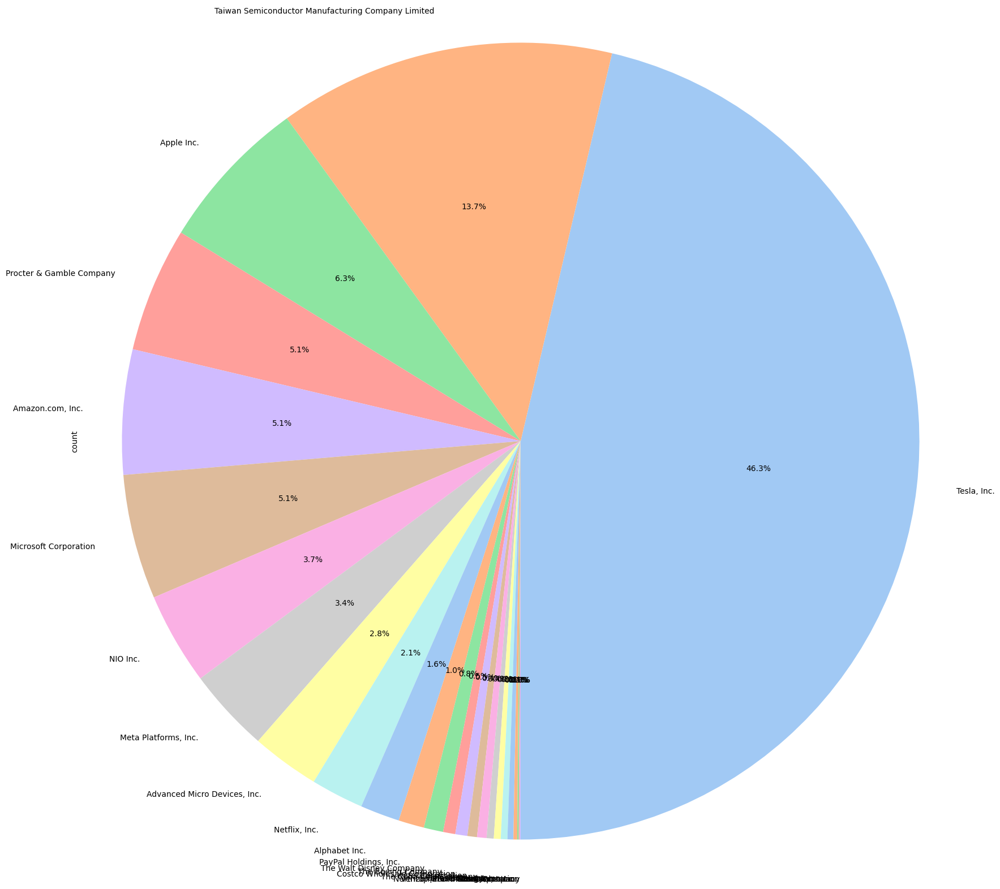

In [ ]:
plt.figure(figsize=(20, 20))
df1['Company Name'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90,
                                        colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [ ]:
fig = go.Figure(data=[go.Bar(x=df1['Company Name'].value_counts().index, y=df1['Company Name'].value_counts())])
fig.update_layout(title='Countplot for Company Name', xaxis_title= 'Company Name',
                  yaxis_title="Count", height=800, width=800)
fig.show()

In [ ]:
fig = px.pie(df1, names='Company Name', title='Company Name Distribution')
fig.update_layout(
    title='Company Name Distribution',
    height=800,
    width=800
)
fig.show()

In [ ]:
df1['Date'] = pd.to_datetime(df1['Date'])

In [ ]:
df11 = df1.copy()

In [ ]:
df11

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,earning horizon quick snapshot large increase ...,XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavering pu...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.


The format you provided, "2022-09-29 23:41:16+00:00," is in ISO 8601 date and time format with a time zone offset. Here's a breakdown of its components:

"2022" is the year.
"09" is the month (September).
"29" is the day of the month.
"23" is the hour in 24-hour format (in this case, 11:00 PM).
"41" is the minute.
"16" is the second.
"+00:00" represents the time zone offset, which in this case is UTC (Coordinated Universal Time), with no offset from UTC (indicating the time is in UTC).
So, the provided timestamp represents a date and time of September 29, 2022, at 11:41:16 PM (23:41:16) in the UTC time zone.

In [ ]:
df11.set_index('Date', inplace=True)

In [ ]:
start_date = df11.index.min()
end_date = df11.index.max()

In [ ]:
print("Start Date of Stocks:", start_date)
print("End Date of Stocks:", end_date)

Start Date of Stocks: 2021-09-30 00:06:02+00:00
End Date of Stocks: 2022-09-29 23:41:16+00:00


In [ ]:
week_delta = pd.Timedelta(days=7)
current_date = start_date

In [ ]:
while current_date <= end_date:
    start_week = current_date
    end_week = current_date + week_delta
    current_week_data = df11[(df11.index >= start_week) & (df11.index < end_week)]
    weekly_counts = current_week_data.resample('D').size()
    fig = px.bar(weekly_counts, x=weekly_counts.index, y=weekly_counts.values,
                 labels={'x': 'Date', 'y': 'Number of Tweets'},
                 title=f'Tweets for Week {start_week.strftime("%Y-%m-%d")} to {end_week.strftime("%Y-%m-%d")}')
    fig.update_layout(xaxis_tickangle=-45)
    fig.show()
    current_date += week_delta

In [ ]:
daily_counts = df11.resample('D').size()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Bar(x=daily_counts.index, y=daily_counts.values,
                     marker_color='skyblue'))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    weekly_data = source_data.resample('W').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    monthly_data = source_data.resample('M').size()
    fig.add_trace(go.Scatter(x=monthly_data.index, y=monthly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Month-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    weekly_data = source_data.resample('SM').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    weekly_data = source_data.resample('Q').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    weekly_data = source_data.resample('W').size()
    fig.add_trace(go.Scatter(x=weekly_data.index, y=weekly_data.values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Week-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Stock Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines + markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
fig = go.Figure()
for source_name, source_data in df11.groupby('Company Name'):
    fig.add_trace(go.Scatter(x=source_data.resample('D').size().index, y=source_data.resample('D').size().values,
                            mode='lines + markers', name=source_name))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

In [ ]:
df11

,Tweet,Stock Name,Company Name
Date,,,
2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc."
2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc."
2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc."
2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc."
2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc."
...,...,...,...
2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.
2021-10-04 17:05:59+00:00,earning horizon quick snapshot large increase ...,XPEV,XPeng Inc.
2021-10-01 04:43:41+00:00,record delivery result testimony unwavering pu...,XPEV,XPeng Inc.


In [ ]:
#NLP

In [ ]:
def clean_text(text):
    text = text.lower()
    return text.strip()

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

In [ ]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def remove_punctuation(text):
    punctuationfree="".join([i for i in text if i not in string.punctuation])
    return punctuationfree

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_punctuation(x))

In [ ]:
import re

In [ ]:
def tokenization(text):
    tokens = re.split('W+',text)
    return tokens

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: tokenization(x))

In [ ]:
import nltk
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')
stopwords[0:10]
['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [ ]:
def remove_stopwords(text):
    output= " ".join(i for i in text if i not in stopwords)
    return output

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_stopwords(x))

In [ ]:
def clean_text(text):
    text = re.sub('\[.*\]','', text).strip()
    text = re.sub('\S*\d\S*\s*','', text).strip()
    return text.strip()

1. `text = re.sub('\[.*\]','', text).strip()`: This line uses the `re.sub` function from the `re` module to perform regular expression-based substitution. It replaces any substring that matches the pattern `'\[.*\]'` with an empty string `''`. Here's what the pattern means:
   - `\['.*'\]`: This pattern matches square brackets `[` and `]` enclosing any characters `.*` (zero or more characters). Essentially, it matches and removes anything enclosed in square brackets, including the brackets themselves.
   - `text` is the input text that you want to clean.
   - `.strip()`: Finally, the `.strip()` method is called on the result to remove any leading or trailing whitespace.

2. `text = re.sub('\S*\d\S*\s*','', text).strip()`: This line performs another regular expression substitution. Here's what this pattern does:
   - `\S*\d\S*\s*`: This pattern matches any sequence of characters `\S*` (zero or more non-whitespace characters) that contains at least one digit `\d`. It also matches any following whitespace characters `\s*`.
   - Similar to the first line, this pattern is replaced with an empty string `''`, effectively removing any sequences of characters that contain digits and any trailing whitespace.
   - Again, `.strip()` is called to remove any leading or trailing whitespace from the result.

After these two operations, the `clean_text` function returns the cleaned and preprocessed text.

Overall, this function is useful for removing specific patterns, such as text enclosed in square brackets and sequences of characters containing digits, from a given text, leaving behind a cleaner version of the text.

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

In [ ]:
import spacy
nlp = spacy.load('en_core_web_sm')

nlp = spacy.load('en_core_web_sm'): This line loads a specific spaCy model named 'en_core_web_sm'. Here's what it does:

SpaCy provides various pre-trained language models for different languages and use cases. 'en_core_web_sm' is one of the pre-trained models for the English language, specifically optimized for small to medium-sized text processing tasks.

spacy.load('en_core_web_sm') loads the English language model and initializes it as the nlp object. This object can then be used to process and analyze text in various ways, such as tokenization, part-of-speech tagging, named entity recognition, and more.

In [ ]:
stopwords = nlp.Defaults.stop_words
def lemmatizer(text):
    doc = nlp(text)
    sent = [token.lemma_ for token in doc if not token.text in set(stopwords)]
    return ' '.join(sent)

In [ ]:
df1.Tweet =  df1.Tweet.apply(lambda x: lemmatizer(x))

In [ ]:
def remove_urls(vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)

re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE): This line uses the re.sub function from the re module (Python's regular expressions module) to substitute matches of a regular expression pattern with an empty string.

r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b': This is the regular expression pattern that matches URLs. Let's break it down:

(https|http)?: This part matches either "https" or "http" (with the ? indicating that "s" is optional), which are common URL protocols.
:\/\/: This matches the colon and double slashes ("://") that are typically part of the URL's format.
(\w|\.|\/|\?|\=|\&|\%)*: This part matches any combination of word characters (\w), periods (\.), forward slashes (\/), question marks (\?), equal signs (\=), ampersands (\&), and percent signs (\%). This is the part of the URL that can vary widely.
\b: This \b is a word boundary anchor, ensuring that the match ends at a word boundary.
'': This is the replacement string, which is an empty string. It means that any URL matched by the regular expression will be replaced with nothing, effectively removing it from the text.

vTEXT: This is the input text from which you want to remove URLs.

flags=re.MULTILINE: This flag indicates that the input text can have multiple lines, and the regular expression should be applied to each line individually.

return(vTEXT): Finally, the function returns the modified text with URLs removed.

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_urls(x))

In [ ]:
def remove_digits(text):
    clean_text = re.sub(r"\b[0-9]+\b\s*", "", text)
    return(text)

re.sub(r"\b[0-9]+\b\s*", "", text): This line uses the re.sub function from the re module (Python's regular expressions module) to substitute matches of a regular expression pattern with an empty string.

r"\b[0-9]+\b\s*": This is the regular expression pattern that matches digits within words and any following whitespace. Let's break it down:

\b: This is a word boundary anchor, ensuring that the match starts at a word boundary.
[0-9]+: This part matches one or more digits (0 to 9). [0-9] is a character class that matches any single digit, and + indicates one or more occurrences.
\b: This is another word boundary anchor, ensuring that the match ends at a word boundary.
\s*: This part matches zero or more whitespace characters (spaces or tabs) that may appear after the digits. \s matches whitespace, and * indicates zero or more occurrences.
"": This is the replacement string, which is an empty string. It means that any sequence of digits within words, as well as any following whitespace, will be replaced with nothing, effectively removing them from the text.

text: This is the input text from which you want to remove digits.

return(text): Finally, the function returns the modified text with digits removed.

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_digits(x))

In [ ]:
def remove_digits1(sample_text):
    clean_text = " ".join([w for w in sample_text.split() if not w.isdigit()])
    return(clean_text)

sample_text.split(): This part splits the sample_text into a list of words. It uses whitespace as the default separator, so it splits the text into individual words.

List Comprehension: [w for w in sample_text.split() if not w.isdigit()]

This is a list comprehension that iterates through each word (w) in the list of words generated by sample_text.split().

w.isdigit(): This condition checks if the current word w consists entirely of digits. The isdigit() method returns True if all characters in the string are digits; otherwise, it returns False.

if not w.isdigit(): This condition checks if the word w is NOT composed entirely of digits. If the word contains any non-digit characters, it evaluates to True.

[w for w in sample_text.split() if not w.isdigit()]: This list comprehension creates a new list that includes only those words from the original list of words that do NOT consist entirely of digits.

" ".join(...): This part joins the filtered list of words back together into a single string, with each word separated by a space. This effectively removes any words that consisted only of digits.

return(clean_text): Finally, the function returns the modified text with digits removed.

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_digits1(x))

In [ ]:
def remove_emojis(data):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"
                               u"\U0001F300-\U0001F5FF"
                               u"\U0001F680-\U0001F6FF"
                               u"\U0001F1E0-\U0001F1FF"
                               "]+", flags=re.UNICODE)
    return re.sub(emoji_pattern, '', data)


The remove_emojis function you've provided is a Python function that takes a text input (data) and removes any emoji characters from it using regular expressions. Emojis are a form of special characters, and this function uses a regular expression pattern to match and remove them from the input text. Here's how it works:

emoji_pattern: This variable contains a regular expression pattern that is designed to match various ranges of Unicode characters associated with emojis. It uses Unicode code ranges to cover a wide range of emoji characters. The specific ranges used in this pattern are:

\U0001F600-\U0001F64F: Emoticons (e.g., 😃, 😊)
\U0001F300-\U0001F5FF: Miscellaneous Symbols and Pictographs (e.g., 🌟, 🌺)
\U0001F680-\U0001F6FF: Transport and Map Symbols (e.g., 🚗, 🚀)
\U0001F1E0-\U0001F1FF: Regional Indicator Symbols (used for flags, e.g., 🇺🇸)
re.UNICODE: This flag is used with the re.compile function to ensure that Unicode characters in the input text are properly matched.

re.sub(emoji_pattern, '', data): This line of code uses the re.sub function from Python's re module to replace all matches of the emoji_pattern in the data string with an empty string (''). This effectively removes all emoji characters from the input text.

In [ ]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_emojis(x))

In [ ]:
df1

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,earn horizon quick snapshot large increase con...,XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavere purs...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.


In [ ]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

SentimentIntensityAnalyzer:

SentimentIntensityAnalyzer is a class provided by the Natural Language Toolkit (NLTK) library, specifically in the nltk.sentiment.vader module.
It's a tool for performing sentiment analysis on text data.
Sentiment analysis involves determining the sentiment or emotional tone expressed in a piece of text, whether it's positive, negative, or neutral.
nltk.download('vader_lexicon'):

This is a Python code snippet used to download the VADER (Valence Aware Dictionary and sEntiment Reasoner) lexicon.
VADER is a pre-built sentiment analysis tool that comes with a predefined lexicon of words and their associated sentiment scores.
The lexicon contains thousands of words, each assigned a polarity score, which indicates how positive, negative, or neutral the word is.
Downloading the VADER lexicon is necessary before you can use the SentimentIntensityAnalyzer, as the analyzer relies on this lexicon to assess sentiment.

In [ ]:
def get_sentiment_label(text):
    sia = SentimentIntensityAnalyzer()
    sentiment_scores = sia.polarity_scores(text)

    if sentiment_scores['compound'] >= 0.05:
        return 'Positive'
    elif sentiment_scores['compound'] <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

In [ ]:
df1['Sentiment_Scores'] = df1['Tweet'].apply(lambda x: SentimentIntensityAnalyzer().polarity_scores(x))

In [ ]:
df1['sentiment'] = df1['Tweet'].apply(get_sentiment_label)

In [ ]:
df1

,Date,Tweet,Stock Name,Company Name,Sentiment_Scores,sentiment
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc.","{'neg': 0.158, 'neu': 0.631, 'pos': 0.211, 'co...",Positive
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 0.896, 'pos': 0.104, 'comp...",Positive
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc.","{'neg': 0.413, 'neu': 0.467, 'pos': 0.12, 'com...",Negative
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc.","{'neg': 0.588, 'neu': 0.412, 'pos': 0.0, 'comp...",Negative
...,...,...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral
80789,2021-10-04 17:05:59+00:00,earn horizon quick snapshot large increase con...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.803, 'pos': 0.197, 'comp...",Positive
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavere purs...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",Positive
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.833, 'pos': 0.167, 'comp...",Positive


In [ ]:
df1.rename(columns={'sentiment': 'Sentiment'}, inplace=True)

In [ ]:
df1.to_csv('stock_tweets_sentiments.csv', index=False)

In [ ]:
df1['Sentiment'].unique()

array(['Positive', 'Neutral', 'Negative'], dtype=object)

In [ ]:
df1["Sentiment"].value_counts()

,count
Sentiment,
Positive,40939
Neutral,24187
Negative,15666


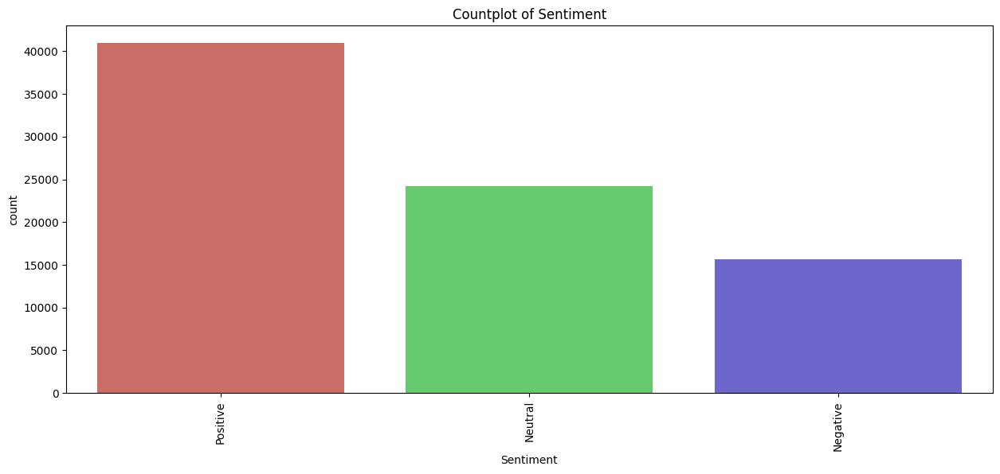

In [ ]:
plt.figure(figsize=(15,6))
sns.countplot(x=df1['Sentiment'], data = df1, palette = 'hls')
plt.xticks(rotation = 90)
plt.title('Countplot of Sentiment')
plt.show()

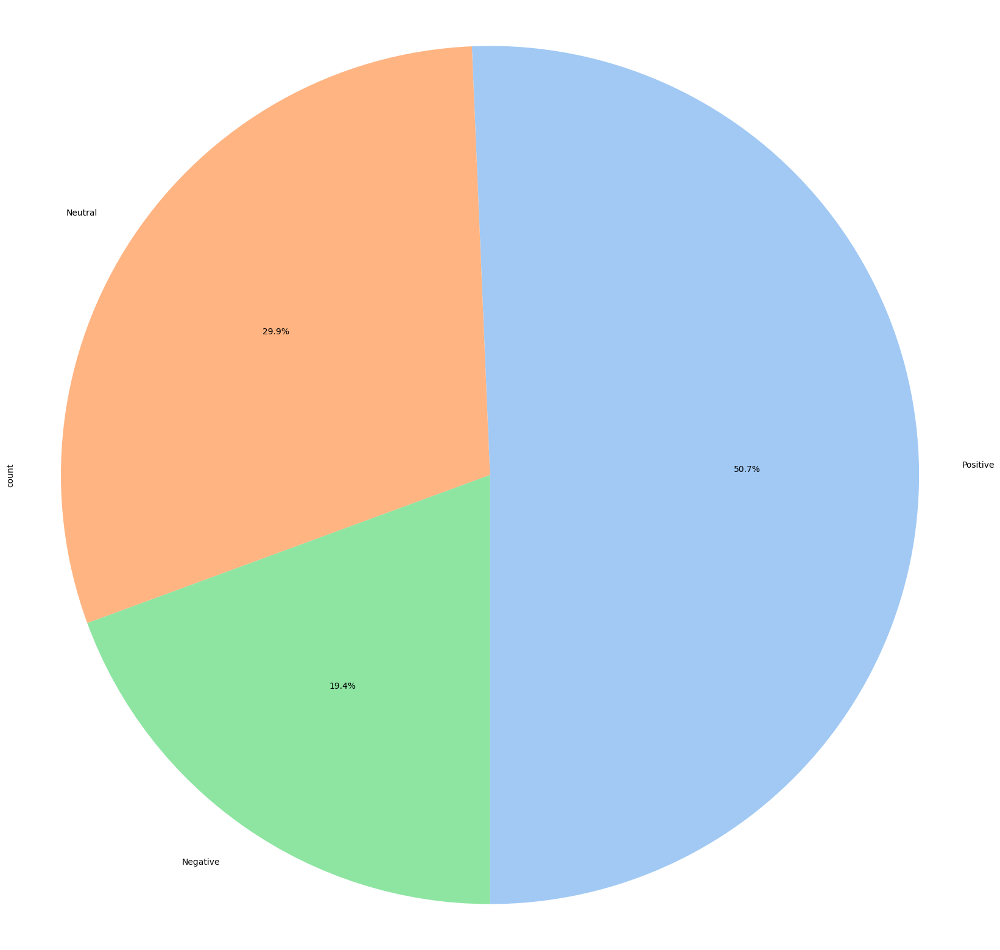

In [ ]:
plt.figure(figsize=(20, 20))
df1['Sentiment'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=-90,
                                        colors=sns.color_palette('pastel'))
plt.axis('equal')
plt.show()

In [ ]:
fig = go.Figure(data=[go.Bar(x=df1['Sentiment'].value_counts().index, y=df1['Sentiment'].value_counts())])
fig.update_layout(title='Countplot for Sentiment', xaxis_title= 'Sentiment',
                  yaxis_title="Count", height=800, width=800)
fig.show()

In [ ]:
fig = px.pie(df1, names='Sentiment', title='Sentiment Distribution')
fig.update_layout(
    title='Sentiment Distribution',
    height=800,
    width=800
)
fig.show()

In [ ]:
import wordcloud

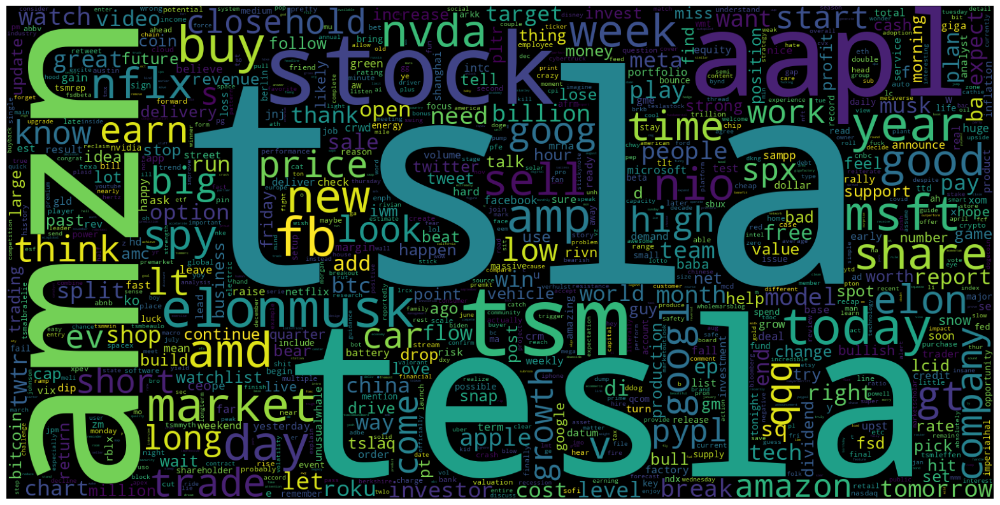

In [ ]:
from wordcloud import WordCloud
data = df1.Tweet
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
# This parameter disables the combination of words (collocations) in the word cloud. Collocations are pairs of words that often appear together in the text.
plt.imshow(wc)
plt.axis('off')
plt.show()

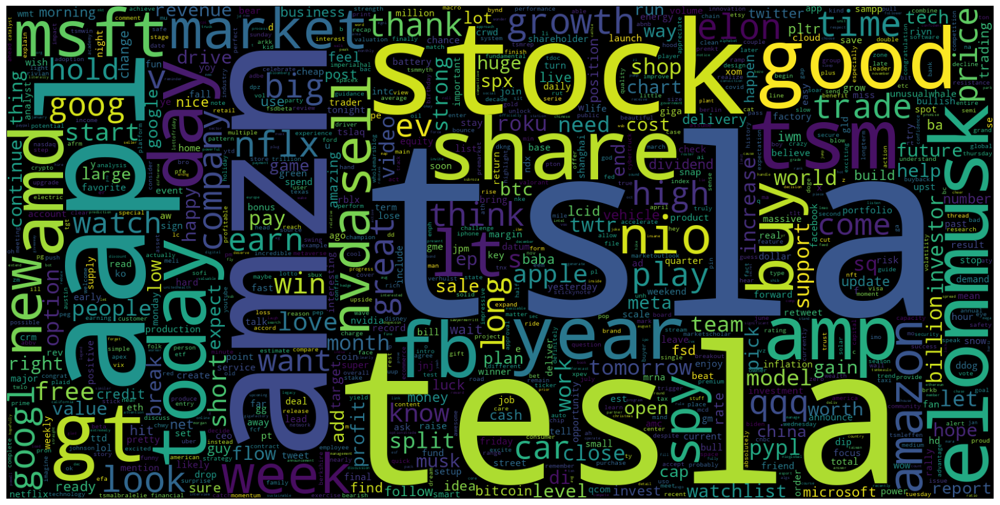

In [ ]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Positive"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

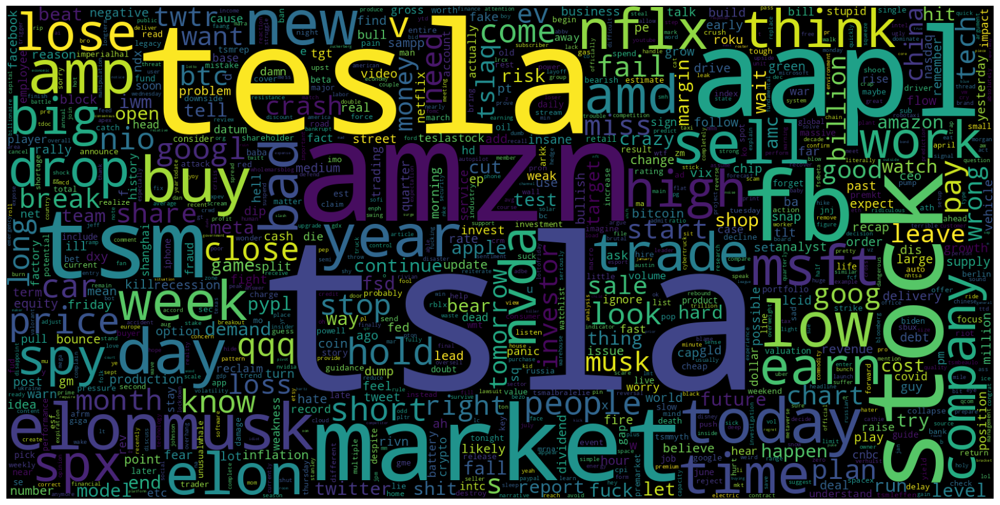

In [ ]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Negative"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

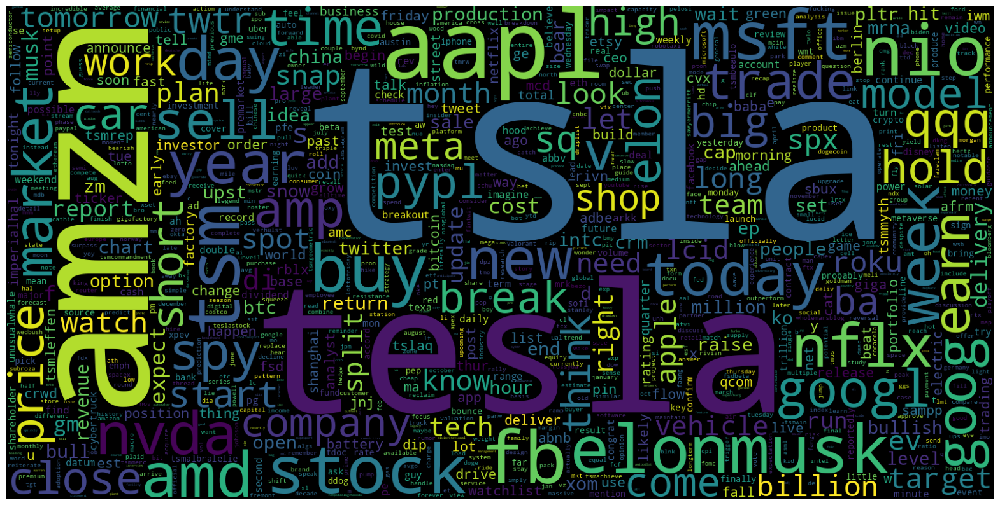

In [ ]:
from wordcloud import WordCloud
data = df1[df1['Sentiment'] == "Neutral"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

In [ ]:
sentiment_counts_stock = df1.groupby(['Stock Name', 'Sentiment']).size().unstack(fill_value=0)

In [ ]:
sentiment_counts_stock

Sentiment,Negative,Neutral,Positive
Stock Name,,,
AAPL,1032,1695,2329
AMD,305,584,1338
AMZN,788,1026,2275
BA,53,140,206
BX,5,12,33
COST,77,138,178
CRM,33,86,114
DIS,103,237,295
ENPH,28,53,135


In [ ]:
sentiment_counts_company = df1.groupby(['Company Name', 'Sentiment']).size().unstack(fill_value=0)

In [ ]:
sentiment_counts_company

Sentiment,Negative,Neutral,Positive
Company Name,,,
"Advanced Micro Devices, Inc.",305,584,1338
Alphabet Inc.,209,418,664
"Amazon.com, Inc.",788,1026,2275
Apple Inc.,1032,1695,2329
Blackstone Inc.,5,12,33
Costco Wholesale Corporation,77,138,178
"Enphase Energy, Inc.",28,53,135
Ford Motor Company,9,6,16
Intel Corporation,62,100,153


In [ ]:
sentiment_counts_company['Total_Positive'] = sentiment_counts_company['Positive']
sentiment_counts_company['Total_Negative'] = sentiment_counts_company['Negative']
sentiment_counts_company['Total_Neutral'] = sentiment_counts_company['Neutral']

In [ ]:
company_highest_positive = sentiment_counts_company['Total_Positive'].idxmax()
highest_positive_count = sentiment_counts_company['Total_Positive'].max()

company_highest_negative = sentiment_counts_company['Total_Negative'].idxmax()
highest_negative_count = sentiment_counts_company['Total_Negative'].max()

company_highest_neutral = sentiment_counts_company['Total_Neutral'].idxmax()
highest_neutral_count = sentiment_counts_company['Total_Neutral'].max()

company_lowest_positive = sentiment_counts_company['Total_Positive'].idxmin()
lowest_positive_count = sentiment_counts_company['Total_Positive'].min()

company_lowest_negative = sentiment_counts_company['Total_Negative'].idxmin()
lowest_negative_count = sentiment_counts_company['Total_Negative'].min()

company_lowest_neutral = sentiment_counts_company['Total_Neutral'].idxmin()
lowest_neutral_count = sentiment_counts_company['Total_Neutral'].min()

print(f"Company with Highest Positive Sentiment Count: {company_highest_positive} ({highest_positive_count} positive sentiments)")
print(f"Company with Highest Negative Sentiment Count: {company_highest_negative} ({highest_negative_count} negative sentiments)")
print(f"Company with Highest Neutral Sentiment Count: {company_highest_neutral} ({highest_neutral_count} neutral sentiments)")

print(f"Company with Lowest Positive Sentiment Count: {company_lowest_positive} ({lowest_positive_count} positive sentiments)")
print(f"Company with Lowest Negative Sentiment Count: {company_lowest_negative} ({lowest_negative_count} negative sentiments)")
print(f"Company with Lowest Neutral Sentiment Count: {company_lowest_neutral} ({lowest_neutral_count} neutral sentiments)")

Company with Highest Positive Sentiment Count: Tesla, Inc. (18584 positive sentiments)
Company with Highest Negative Sentiment Count: Tesla, Inc. (7743 negative sentiments)
Company with Highest Neutral Sentiment Count: Tesla, Inc. (11095 neutral sentiments)
Company with Lowest Positive Sentiment Count: Ford Motor Company (16 positive sentiments)
Company with Lowest Negative Sentiment Count: Blackstone Inc. (5 negative sentiments)
Company with Lowest Neutral Sentiment Count: Ford Motor Company (6 neutral sentiments)


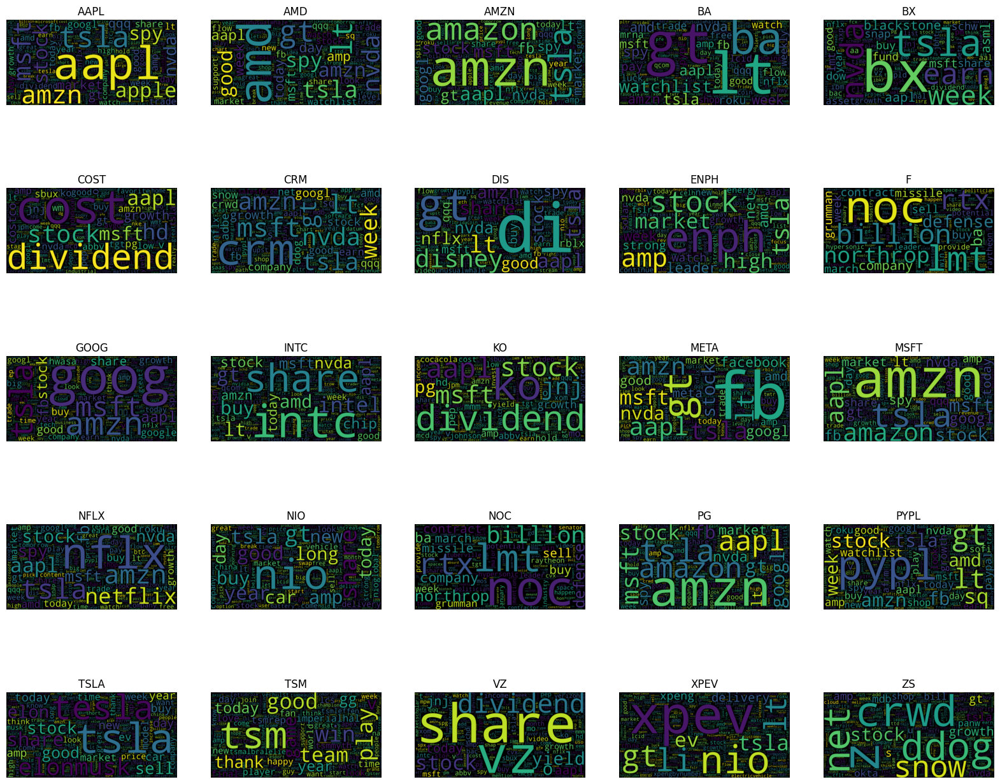

In [ ]:
positive_data = df1[df1['Sentiment'] == "Positive"]

grouped_data = positive_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

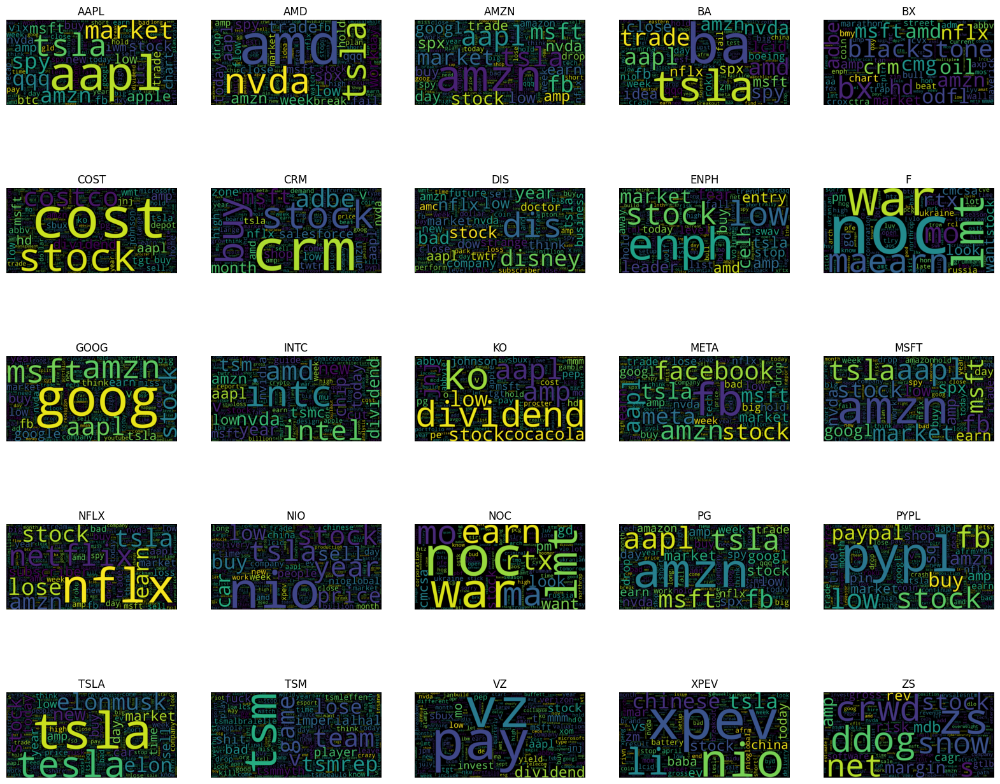

In [ ]:
negative_data = df1[df1['Sentiment'] == "Negative"]

grouped_data = negative_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

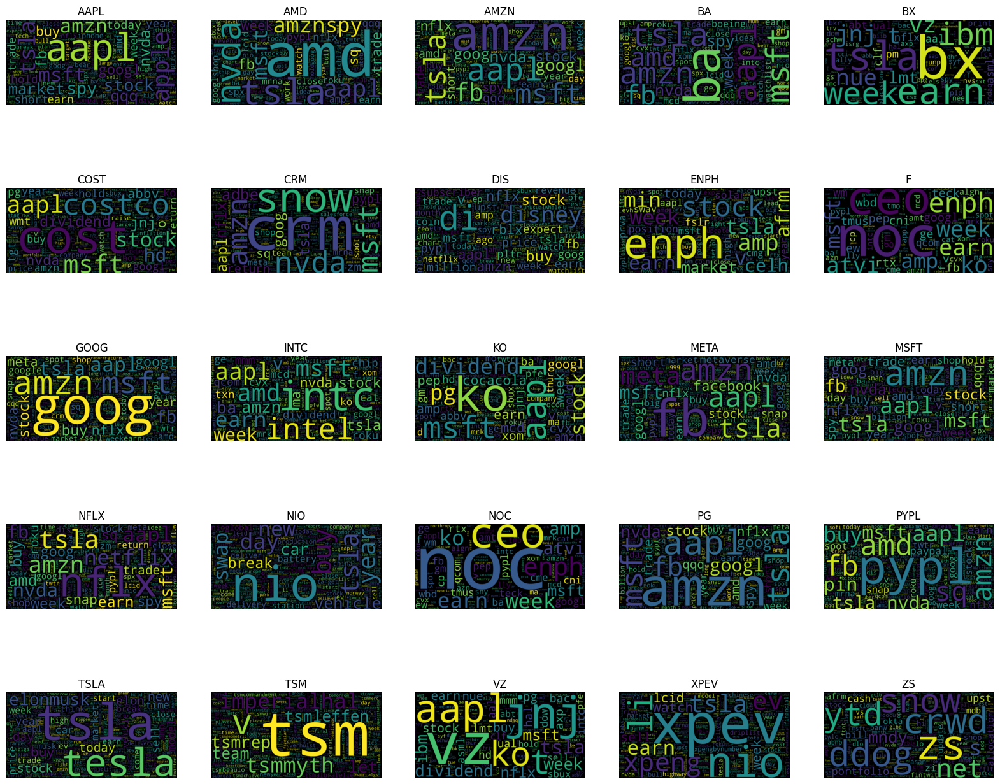

In [ ]:
neutral_data = df1[df1['Sentiment'] == "Neutral"]

grouped_data = neutral_data.groupby('Stock Name')

num_plots = min(len(grouped_data), 25)
rows, cols = (num_plots // 5) + 1, min(num_plots, 5)

plt.figure(figsize=(20, 20))
for i, (stock_name, data) in enumerate(grouped_data):
    wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
    plt.subplot(rows, cols, i + 1)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(stock_name)
    plt.axis('off')

plt.show()

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

TfidfVectorizer stands for "Term Frequency-Inverse Document Frequency Vectorizer." It's a feature extraction technique commonly used in natural language processing and information retrieval. Here's a brief explanation:

Term Frequency (TF): It measures how frequently a term (word) appears in a document. In other words, it calculates the number of times a word occurs in a text.

Inverse Document Frequency (IDF): It measures the importance of a term in a collection of documents (corpus). Words that appear in many documents have a lower IDF, while words that appear in only a few documents have a higher IDF. The purpose of IDF is to give more weight to terms that are relatively rare because they may carry more meaningful information.

TF-IDF: This is the product of TF and IDF. It combines information about the frequency of a term in a specific document with its rarity across the entire corpus. TF-IDF assigns a higher value to terms that are both frequent in a document and unique to that document.

TfidfVectorizer is used to convert a collection of raw text documents into a matrix of TF-IDF features. It takes care of preprocessing the text (e.g., tokenization, lowercasing, removing stop words) and computes the TF-IDF values for each term in each document. The result is a matrix where each row represents a document, and each column represents a unique term in the corpus.

In natural language processing and machine learning, this TF-IDF matrix is often used as input for various text classification and clustering algorithms. It helps in representing text data in a format that can be processed by machine learning models.

You can configure various parameters of TfidfVectorizer to control its behavior, such as specifying the maximum number of features (terms), customizing tokenization, and more, depending on your specific text data and task.

In [ ]:
tf1=TfidfVectorizer()
data_vec=tf1.fit_transform(df1['Tweet'])

In [ ]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df1['Sentiment_Label'] = label_encoder.fit_transform(df1['Sentiment'])

In [ ]:
y=df1['Sentiment_Label'].values

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(data_vec,y,test_size=0.2,stratify = y, random_state=42)

In [ ]:
from imblearn.over_sampling import SMOTE

In [ ]:
smote = SMOTE(random_state=42)
X_balanced, y_balanced = smote.fit_resample(X_train, y_train)

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [ ]:
dt = DecisionTreeClassifier()
rf = RandomForestClassifier()

In [ ]:
models = [dt, rf]

accuracies = []

for model in models:
    print('Results for the model:', model.__class__.__name__)
    model.fit(X_balanced, y_balanced)
    Y_train_bal = model.predict(X_balanced)
    y_pred = model.predict(X_test)

    training_accuracy = accuracy_score(Y_train_bal, y_balanced)
    print('Training Accuracy:', training_accuracy)

    accuracy = accuracy_score(y_test, y_pred)
    print('Accuracy:', accuracy)

    cm = confusion_matrix(y_test, y_pred)
    print('Confusion Matrix:\n', cm)

    report = classification_report(y_test, y_pred)
    print('Classification Report:\n', report)

    print('\n')

    accuracies.append(accuracy)

print('List of Accuracies:', accuracies)

Results for the model: DecisionTreeClassifier
Training Accuracy: 1.0
Accuracy: 0.8737545640200507
Confusion Matrix:
 [[2380  286  467]
 [ 140 4535  163]
 [ 583  401 7204]]
Classification Report:
               precision    recall  f1-score   support

           0       0.77      0.76      0.76      3133
           1       0.87      0.94      0.90      4838
           2       0.92      0.88      0.90      8188

    accuracy                           0.87     16159
   macro avg       0.85      0.86      0.85     16159
weighted avg       0.87      0.87      0.87     16159



Results for the model: RandomForestClassifier
Training Accuracy: 1.0
Accuracy: 0.9076056686676156
Confusion Matrix:
 [[2488  273  372]
 [  74 4658  106]
 [ 273  395 7520]]
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.79      0.83      3133
           1       0.87      0.96      0.92      4838
           2       0.94      0.92      0.93      8188

    acc

In [ ]:
model_names = ['DecisionTree', 'RandomForest']
fig = go.Figure(data=go.Bar(x=model_names, y=accuracies))
fig.update_layout(title='Model Accuracies',
                  xaxis_title='Model',
                  yaxis_title='Accuracy',
                  yaxis_tickformat='.2%',
                  yaxis_range=[0, 1],
                  xaxis_tickangle=0)
fig.show()

In [ ]:
import pandas as pd

# Step 1: Load the dataset
file_path = '/content/stock_tweets_sentiments_new.csv'
data = pd.read_csv(file_path)
# Step 2: Map sentiment labels to numerical values
sentiment_map = {'Positive': 1, 'Neutral': 0, 'Negative': -1}
data['Sentiment_Score'] = data['Sentiment'].map(sentiment_map)

# Step 3: Define a rule-based stock movement predictor
def predict_stock_movement(sentiment_score):
    if sentiment_score > 0:
        return "Increased approx 0.5%"
    elif sentiment_score < 0:
        return "Decreased approx 0.5%"
    else:
        return "No significant change"

# Step 4: Apply the prediction logic
data['Stock_Movement'] = data['Sentiment_Score'].apply(predict_stock_movement)

# Step 5: Save the results to a new file
output_file_path = 'stock_movement_predictions.csv'
data.to_csv(output_file_path, index=False)

# Display the first few rows of the dataset
print(data[['Date', 'Stock Name', 'Company Name', 'Sentiment', 'Sentiment_Score', 'Stock_Movement']])

# Step 6: Function to query stock movement by stock name and company
def get_stock_movement(stock_name, company_name):
    filtered_data = data[(data['Stock Name'] == stock_name) & (data['Company Name'] == company_name)]

    if not filtered_data.empty:
        # Display the predicted stock movement for the specified stock and company
        return filtered_data[['Date', 'Sentiment', 'Stock_Movement']]
    else:
        return f"No data available for stock: {stock_name} and company: {company_name}"

# Step 7: Example usage: Query for a specific stock and company
stock_name_input = input("Enter the stock name (e.g., TSLA): ")
company_name_input = input("Enter the company name (e.g., Tesla): ")

predicted_movement = get_stock_movement(stock_name_input, company_name_input)
print(predicted_movement)

# Results saved to the CSV file
print(f"\nResults saved to: {output_file_path}")


                            Date Stock Name Company Name Sentiment  \
0      2022-09-29 23:41:16+00:00       TSLA  Tesla, Inc.  Positive   
1      2022-09-29 23:24:43+00:00       TSLA  Tesla, Inc.   Neutral   
2      2022-09-29 23:18:08+00:00       TSLA  Tesla, Inc.  Positive   
3      2022-09-29 22:40:07+00:00       TSLA  Tesla, Inc.  Negative   
4      2022-09-29 22:27:05+00:00       TSLA  Tesla, Inc.  Negative   
...                          ...        ...          ...       ...   
80788  2021-10-07 17:11:57+00:00       XPEV   XPeng Inc.   Neutral   
80789  2021-10-04 17:05:59+00:00       XPEV   XPeng Inc.  Positive   
80790  2021-10-01 04:43:41+00:00       XPEV   XPeng Inc.  Positive   
80791  2021-10-01 00:03:32+00:00       XPEV   XPeng Inc.  Positive   
80792  2021-09-30 10:22:52+00:00       XPEV   XPeng Inc.  Positive   

       Sentiment_Score         Stock_Movement  
0                    1  Increased approx 0.5%  
1                    0  No significant change  
2              